In [37]:
import urllib2
import urllib
import StringIO
import ast
import pandas as pd
from IPython.display import Image

SQL_SOURCE = 'https://mjs639.carto.com/api/v2/sql?q='


def queryCartoDB(query, format='CSV', source=SQL_SOURCE):
    '''queries carto datasets from a given carto account
    Arguments: 
    query - string: a valid sql query string
    format - outlut format  OPTIONAL (default CSV)
    source - a valid sql api endpoint OPTIONAL (default carto fb55 account)
    Returns:
    the return of the sql query AS A STRING
    NOTES:
    designed for the carto API, tested only with CSV return format'''
    
    data = urllib.urlencode({'format': format, 'q': query})
    try:
        response = urllib2.urlopen(source, data)
    except urllib2.HTTPError, e:
        raise ValueError('\n'.join(ast.literal_eval(e.readline())['error']))
    except Exception:
        raise
    return response.read()

In [35]:
task1 = '''
SELECT * 
FROM citibike
WHERE tripduration<10800
ORDER BY start_station_id, tripduration
LIMIT 10
'''

pd.read_csv(StringIO.StringIO(queryCartoDB(task1)), sep=',')

,cartodb_id,the_geom,the_geom_webmercator,gender,birth_year,bikeid,end_station_id,start_station_id,tripduration,usertype,end_station_name,start_station_name,end_station_longitude,end_station_latitude,start_station_longitude,start_station_latitude,stoptime,starttime
0,8998,NaN,NaN,2,1980,19039,72,72,107,Subscriber,W 52 St & 11 Ave,W 52 St & 11 Ave,-73.993929,40.767272,-73.993929,40.767272,2015-02-03 10:12:00+00,2015-02-03 10:10:00+00
1,40759,NaN,NaN,2,1959,18131,72,72,189,Subscriber,W 52 St & 11 Ave,W 52 St & 11 Ave,-73.993929,40.767272,-73.993929,40.767272,2015-02-07 10:43:00+00,2015-02-07 10:40:00+00
2,40757,NaN,NaN,1,1995,19729,72,72,229,Subscriber,W 52 St & 11 Ave,W 52 St & 11 Ave,-73.993929,40.767272,-73.993929,40.767272,2015-02-07 10:44:00+00,2015-02-07 10:40:00+00
3,21948,NaN,NaN,1,1970,16879,478,72,248,Subscriber,11 Ave & W 41 St,W 52 St & 11 Ave,-73.998842,40.760301,-73.993929,40.767272,2015-02-05 06:24:00+00,2015-02-05 06:19:00+00
4,43099,NaN,NaN,1,1983,15277,515,72,252,Subscriber,W 43 St & 10 Ave,W 52 St & 11 Ave,-73.994618,40.760094,-73.993929,40.767272,2015-02-07 15:47:00+00,2015-02-07 15:43:00+00
5,32566,NaN,NaN,1,1971,18492,478,72,261,Subscriber,11 Ave & W 41 St,W 52 St & 11 Ave,-73.998842,40.760301,-73.993929,40.767272,2015-02-06 09:02:00+00,2015-02-06 08:58:00+00
6,15971,NaN,NaN,1,1961,19216,478,72,276,Subscriber,11 Ave & W 41 St,W 52 St & 11 Ave,-73.998842,40.760301,-73.993929,40.767272,2015-02-04 12:51:00+00,2015-02-04 12:46:00+00
7,41355,NaN,NaN,1,1974,21588,447,72,283,Subscriber,8 Ave & W 52 St,W 52 St & 11 Ave,-73.985162,40.763707,-73.993929,40.767272,2015-02-07 12:15:00+00,2015-02-07 12:10:00+00
8,42074,NaN,NaN,1,1978,19124,514,72,288,Subscriber,12 Ave & W 40 St,W 52 St & 11 Ave,-74.002777,40.760875,-73.993929,40.767272,2015-02-07 13:54:00+00,2015-02-07 13:50:00+00
9,2282,NaN,NaN,1,1974,18174,447,72,301,Subscriber,8 Ave & W 52 St,W 52 St & 11 Ave,-73.985162,40.763707,-73.993929,40.767272,2015-02-01 13:13:00+00,2015-02-01 13:08:00+00


In [24]:
task2 = '''
SELECT AVG(tripduration) as avt, AVG(birth_year) as avb
FROM citibike
'''

pd.read_csv(StringIO.StringIO(queryCartoDB(task2)), sep=',')

,avt,avb
0,675.865823,1975.352775


In [25]:
task3 = '''
SELECT *
FROM citibike
WHERE starttime >= '2015-02-02 00:00'
  AND starttime < '2015-02-03 00:00'
'''

pd.read_csv(StringIO.StringIO(queryCartoDB(task3)), sep=',')

,cartodb_id,the_geom,the_geom_webmercator,gender,birth_year,bikeid,end_station_id,start_station_id,tripduration,usertype,end_station_name,start_station_name,end_station_longitude,end_station_latitude,start_station_longitude,start_station_latitude,stoptime,starttime
0,6442,NaN,NaN,1,1992.0,20684,489,442,199,Subscriber,10 Ave & W 28 St,W 27 St & 7 Ave,-74.001768,40.750664,-73.993915,40.746647,2015-02-02 00:05:00+00,2015-02-02 00:02:00+00
1,6443,NaN,NaN,2,1964.0,16094,349,326,418,Subscriber,Rivington St & Ridge St,E 11 St & 1 Ave,-73.983299,40.718502,-73.984267,40.729538,2015-02-02 00:10:00+00,2015-02-02 00:03:00+00
2,6444,NaN,NaN,1,1974.0,17362,415,279,276,Subscriber,Pearl St & Hanover Square,Peck Slip & Front St,-74.009260,40.704718,-74.001670,40.707873,2015-02-02 00:09:00+00,2015-02-02 00:04:00+00
3,6445,NaN,NaN,2,1992.0,15475,237,496,420,Subscriber,E 11 St & 2 Ave,E 16 St & 5 Ave,-73.986724,40.730473,-73.992390,40.737262,2015-02-02 00:13:00+00,2015-02-02 00:06:00+00
4,6446,NaN,NaN,1,1968.0,16272,450,477,304,Subscriber,W 49 St & 8 Ave,W 41 St & 8 Ave,-73.987882,40.762272,-73.990026,40.756405,2015-02-02 00:12:00+00,2015-02-02 00:07:00+00
5,6447,NaN,NaN,1,1979.0,16370,391,467,622,Subscriber,Clark St & Henry St,Dean St & 4 Ave,-73.993446,40.697601,-73.978951,40.683125,2015-02-02 00:18:00+00,2015-02-02 00:08:00+00
6,6448,NaN,NaN,1,1963.0,19437,482,434,371,Subscriber,W 15 St & 7 Ave,9 Ave & W 18 St,-73.999318,40.739355,-74.003664,40.743174,2015-02-02 00:15:00+00,2015-02-02 00:09:00+00
7,6449,NaN,NaN,1,1982.0,21211,2008,330,477,Subscriber,Little West St & 1 Pl,Reade St & Broadway,-74.016777,40.705693,-74.005628,40.714505,2015-02-02 00:19:00+00,2015-02-02 00:11:00+00
8,6450,NaN,NaN,2,1978.0,21417,423,521,743,Subscriber,W 54 St & 9 Ave,8 Ave & W 31 St,-73.986905,40.765849,-73.994811,40.750450,2015-02-02 00:25:00+00,2015-02-02 00:12:00+00
9,6451,NaN,NaN,1,1956.0,15722,453,504,599,Subscriber,W 22 St & 8 Ave,1 Ave & E 15 St,-73.999154,40.744751,-73.981656,40.732219,2015-02-02 00:22:00+00,2015-02-02 00:12:00+00


In [26]:
task4 = '''
SELECT AVG(tripduration)
FROM citibike
WHERE extract(DOW from starttime) NOT IN (0,6) 
'''

pd.read_csv(StringIO.StringIO(queryCartoDB(task4)), sep=',')

,avg,Unnamed: 1
0,681.052292,NaN


In [27]:
task5 = '''
SELECT start_station_latitude, start_station_longitude
FROM citibike
GROUP BY start_station_latitude, start_station_longitude
'''

pd.read_csv(StringIO.StringIO(queryCartoDB(task5)), sep=',')

,start_station_latitude,start_station_longitude
0,40.686919,-73.976682
1,40.753202,-73.977987
2,40.715422,-74.011220
3,40.745497,-74.001971
4,40.744751,-73.999154
5,40.742065,-74.004432
6,40.740964,-73.986022
7,40.763406,-73.977225
8,40.716059,-73.991908
9,40.714948,-74.002345


In [28]:
task6 = '''
SELECT start_station_id, COUNT(*)
FROM citibike
GROUP BY start_station_id, 
start_station_latitude, start_station_longitude
'''

pd.read_csv(StringIO.StringIO(queryCartoDB(task6)), sep=',')

,start_station_id,count
0,438,156
1,342,78
2,242,46
3,161,203
4,373,27
5,168,327
6,502,151
7,421,37
8,511,279
9,422,100


In [30]:
task7 = '''
SELECT CDB_LatLng(start_station_latitude, start_station_longitude) as the_geom
FROM citibike
GROUP BY start_station_id, 
start_station_latitude, start_station_longitude
'''

pd.read_csv(StringIO.StringIO(queryCartoDB(task7)), sep=',')

,the_geom,Unnamed: 1
0,0101000020E610000081446EE1147F52C0DF019643285D...,NaN
1,0101000020E61000009D7A4908BB7E52C02E411DC1D35B...,NaN
2,0101000020E6100000A37CDEE04D7E52C0F3FB063F5459...,NaN
3,0101000020E6100000C5E082E8E07F52C0AB7B6473555D...,NaN
4,0101000020E61000006EE1D4620B7D52C051FADF9DBE58...,NaN
5,0101000020E6100000BF21F9EFA67F52C0183079EAAE5E...,NaN
6,0101000020E6100000DE03745FCE7E52C005A8A9656B5B...,NaN
7,0101000020E61000000ED48CB9297E52C07068A1CF0D59...,NaN
8,0101000020E61000008283E608937E52C0F4705D8C5C5D...,NaN
9,0101000020E6100000234DBC033C7F52C04912842BA062...,NaN


In [31]:
task8 = '''
SELECT CDB_TransformToWebmercator(
           CDB_LatLng(start_station_latitude, 
                      start_station_longitude)) as the_geom_webmercator,
       MIN(cartodb_id) as cartodb_id
FROM citibike
GROUP BY start_station_id, 
start_station_latitude, start_station_longitude
'''

pd.read_csv(StringIO.StringIO(queryCartoDB(task8)), sep=',')

,the_geom_webmercator,cartodb_id
0,0101000020110F0000B77CA834036B5FC19EF5005EBCF7...,79
1,0101000020110F0000BEA7E6966A6A5FC1E90E1AC83EF6...,609
2,0101000020110F0000E097312EB1695FC111C4474A72F3...,454
3,0101000020110F00009B8267C45D6C5FC1577C6302EFF7...,185
4,0101000020110F0000C12D0F658D675FC1323CC0ADCAF2...,6
5,0101000020110F000071CD414CFB6B5FC149C2933772F9...,49
6,0101000020110F00002877F4708B6A5FC1ED3B00D9C9F5...,289
7,0101000020110F00000C641AC573695FC10D6A916323F3...,238
8,0101000020110F000049C345A6266A5FC17E86BFF6F6F7...,69
9,0101000020110F0000CECBC1AD456B5FC149916BC5DDFD...,1386


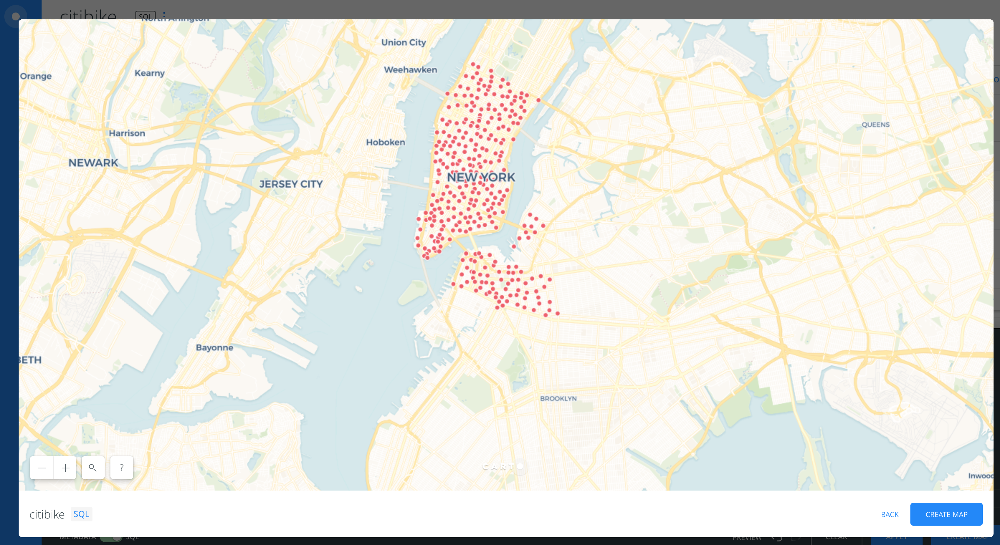

In [50]:
#Map from Task 8
Image("https://raw.githubusercontent.com/mjs639/PUI2017_mjs639/master/HW7_mjs639/Screen%20Shot%202017-11-02%20at%207.13.57%20PM.png")

In [32]:
task9 = '''
SELECT CDB_TransformToWebmercator(
           CDB_LatLng(start_station_latitude, 
                      start_station_longitude)) as the_geom_webmercator,
       MIN(cartodb_id) as cartodb_id 
FROM citibike
WHERE ST_DWithin(CDB_LatLng(start_station_latitude, 
                            start_station_longitude)::geography,
                 CDB_LatLng(40.7577, -73.9857)::geography,
                 500)
GROUP BY start_station_id, 
start_station_latitude, start_station_longitude
'''

pd.read_csv(StringIO.StringIO(queryCartoDB(task9)), sep=',')

,the_geom_webmercator,cartodb_id
0,0101000020110F0000F55695027D6B5FC186E5BB69D7FB...,33
1,0101000020110F00001607D538556B5FC119A6CA6F41FC...,124
2,0101000020110F000004AF971C1D6B5FC17A48F3C1A8FB...,54
3,0101000020110F00009BB87D02B76A5FC146C144E9E5FB...,19
4,0101000020110F0000F22A632FBE6A5FC1363A28CFADFB...,1115
5,0101000020110F00003F9300B2976B5FC1B8B88F3102FC...,783
6,0101000020110F000020D6742CE16A5FC112F4D73D73FC...,42


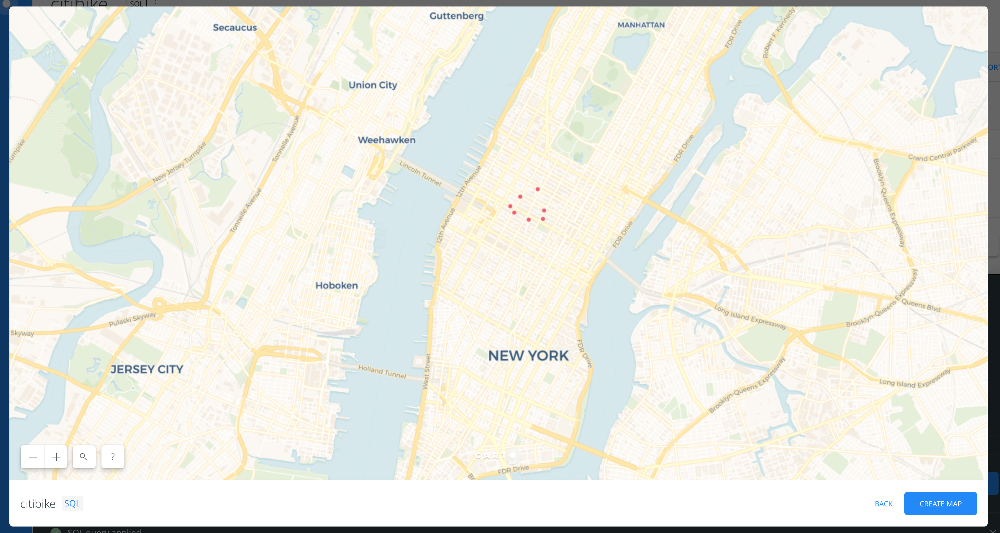

In [51]:
#Map from Task 9
Image("https://raw.githubusercontent.com/mjs639/PUI2017_mjs639/master/HW7_mjs639/Screen%20Shot%202017-11-02%20at%207.20.58%20PM.png")

In [33]:
task10 = '''
SELECT CDB_TransformToWebmercator(
           CDB_LatLng(start_station_latitude, 
                      start_station_longitude)) as the_geom_webmercator,
       MIN(cartodb_id) as cartodb_id, 
       AVG(tripduration) as ta
FROM citibike
WHERE ST_DWithin(CDB_LatLng(start_station_latitude, 
                            start_station_longitude)::geography,
                 CDB_LatLng(40.7577, -73.9857)::geography,
                 500)
GROUP BY start_station_id, 
start_station_latitude, start_station_longitude
'''

pd.read_csv(StringIO.StringIO(queryCartoDB(task10)), sep=',')

,the_geom_webmercator,cartodb_id,ta
0,0101000020110F0000F55695027D6B5FC186E5BB69D7FB...,33,652.753452
1,0101000020110F00001607D538556B5FC119A6CA6F41FC...,124,738.815603
2,0101000020110F000004AF971C1D6B5FC17A48F3C1A8FB...,54,648.023904
3,0101000020110F00009BB87D02B76A5FC146C144E9E5FB...,19,575.560284
4,0101000020110F0000F22A632FBE6A5FC1363A28CFADFB...,1115,605.696429
5,0101000020110F00003F9300B2976B5FC1B8B88F3102FC...,783,663.968326
6,0101000020110F000020D6742CE16A5FC112F4D73D73FC...,42,624.056338


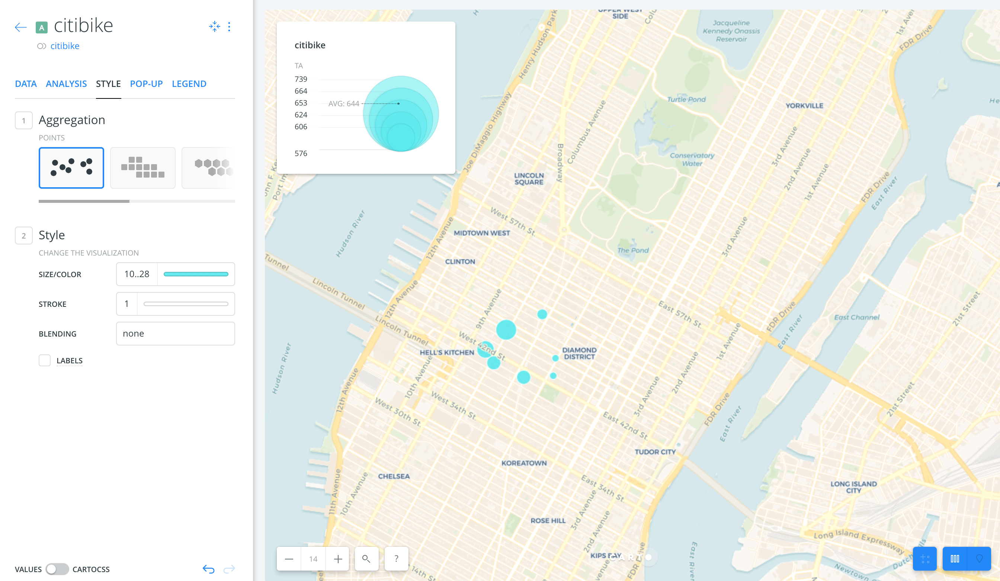

In [52]:
#Map from Task 10
Image("https://raw.githubusercontent.com/mjs639/PUI2017_mjs639/master/HW7_mjs639/Screen%20Shot%202017-11-02%20at%207.27.46%20PM.png")

In [34]:
task11 = '''
SELECT ST_Makeline(
       CDB_TransformToWebmercator(
           CDB_LatLng(start_station_latitude, 
                      start_station_longitude)),
       CDB_TransformToWebmercator(
           CDB_LatLng(end_station_latitude, 
                      end_station_longitude))
       ) as the_geom_webmercator,          
       MIN(cartodb_id) as cartodb_id 
FROM citibike
WHERE ST_DWithin(CDB_LatLng(start_station_latitude, 
                            start_station_longitude)::geography,
                 CDB_LatLng(40.7577, -73.9857)::geography,
                 500)
GROUP BY start_station_id, start_station_latitude, start_station_longitude,
         end_station_id, end_station_latitude, end_station_longitude
'''

pd.read_csv(StringIO.StringIO(queryCartoDB(task11)), sep=',')

,the_geom_webmercator,cartodb_id
0,0102000020110F00000200000020D6742CE16A5FC112F4...,18466
1,0102000020110F000002000000F55695027D6B5FC186E5...,2226
2,0102000020110F00000200000004AF971C1D6B5FC17A48...,15621
3,0102000020110F0000020000009BB87D02B76A5FC146C1...,34734
4,0102000020110F000002000000F22A632FBE6A5FC1363A...,37006
5,0102000020110F00000200000004AF971C1D6B5FC17A48...,6007
6,0102000020110F000002000000F22A632FBE6A5FC1363A...,20272
7,0102000020110F0000020000001607D538556B5FC119A6...,11540
8,0102000020110F0000020000009BB87D02B76A5FC146C1...,13614
9,0102000020110F000002000000F55695027D6B5FC186E5...,39800


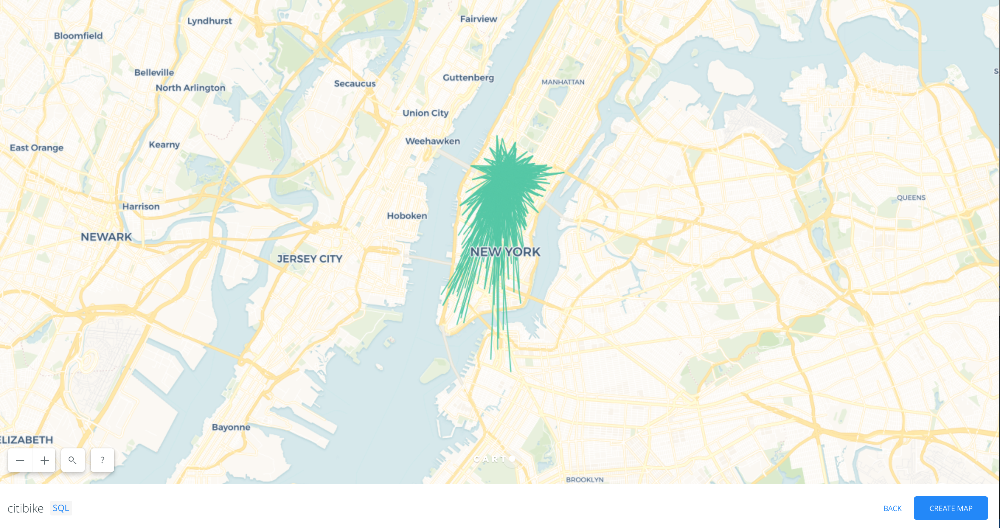

In [53]:
#Map from Task 11
Image("https://raw.githubusercontent.com/mjs639/PUI2017_mjs639/master/HW7_mjs639/Screen%20Shot%202017-11-02%20at%207.32.16%20PM.png")